# Comparison of Methods: 'snaptogrid' vs. 'topology'

In [1]:
import pandas as pd
import geopandas as gpd

from lets_plot import *
from lets_plot.mapping import as_discrete


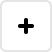
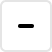
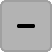
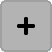
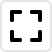
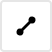
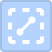
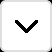
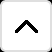
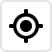

In [2]:
LetsPlot.setup_html()

In [3]:
CSV_INPUT = "data/geocoding.csv"
GEOJSON_INPUT = "data/demo_geoms.geojson"
COUNTRY_RESOLUTION_RANGE = list(range(1, 7))
STATE_RESOLUTION_RANGE = list(range(4, 10))
EXCLUDED_COUNTRIES = ["Italy", "Montenegro", "Poland"]
EXCLUDED_STATES = ["Alaska", "Hawaii"] + \
                  ["American Samoa", "Guam", "Northern Mariana Islands", "Puerto Rico", "United States Virgin Islands"]

In [4]:
df = pd.read_csv(CSV_INPUT)
df = df[~df["name"].isin(EXCLUDED_COUNTRIES)]
print(df.shape)
df.head()

(1830, 10)


,version,kind,name,resolution,exterior_points_count,interior_points_count,points_count,points_ratio,diff_area,rel_diff_area
0,snaptogrid,country,US,1,802,69,871,0.004227,61.304494,0.053319
1,snaptogrid,country,Canada,1,2570,670,3240,0.007282,135.639701,0.076367
2,snaptogrid,country,China,1,432,4,436,0.003025,34.835738,0.035971
3,snaptogrid,country,Greece,1,67,10,77,0.002458,7.397034,0.411959
7,snaptogrid,country,US,2,1879,140,2019,0.009798,36.385796,0.031986


In [5]:
countries_df = df[(df["kind"] == "country")&(df["resolution"].isin(COUNTRY_RESOLUTION_RANGE))].reset_index(drop=True)
print(countries_df.shape)

(48, 10)


In [6]:
states_df = df[(df["kind"] == "state")&(df["resolution"].isin(STATE_RESOLUTION_RANGE))].reset_index(drop=True)
print(states_df.shape)

(684, 10)


In [7]:
gdf = gpd.read_file(GEOJSON_INPUT)
print(gdf.shape)
gdf.head()

(712, 5)


,name,resolution,version,kind,geometry
0,US,1,snaptogrid,country,"MULTIPOLYGON (((-95.62500 28.92163, -95.62500 ..."
1,Canada,1,snaptogrid,country,"MULTIPOLYGON (((-54.14062 47.51720, -54.84375 ..."
2,China,1,snaptogrid,country,"MULTIPOLYGON (((110.39062 19.97335, 111.09375 ..."
3,Greece,1,snaptogrid,country,"MULTIPOLYGON (((22.50000 36.59789, 22.50000 37..."
4,Italy,1,snaptogrid,country,"MULTIPOLYGON (((16.87500 39.90974, 16.87500 39..."


In [8]:
states_gdf = gdf[(gdf["kind"] == "state")&(~gdf["name"].isin(EXCLUDED_STATES))]
print(states_gdf.shape)
states_gdf.head()

(600, 5)


,name,resolution,version,kind,geometry
14,Vermont,1,snaptogrid,state,"MULTIPOLYGON (((-71.71875 44.08759, -72.42188 ..."
15,Massachusetts,1,snaptogrid,state,"MULTIPOLYGON (((-71.01562 42.03297, -71.71875 ..."
16,New York,1,snaptogrid,state,"MULTIPOLYGON (((-73.12500 40.97990, -73.12500 ..."
17,Maine,1,snaptogrid,state,"MULTIPOLYGON (((-68.20312 44.59047, -68.20312 ..."
18,New Hampshire,1,snaptogrid,state,"POLYGON ((-71.01562 43.06889, -71.01562 42.553..."


## 1. Visual Comparison of Geometries Quality

In [9]:
def plot_states_comparison(gdf, *, resolutions=[], xlim=None, ylim=None):
    return ggplot() + \
        geom_map(aes(fill="name"), data=gdf[gdf["resolution"].isin(resolutions)], show_legend=False) + \
        facet_grid(x="version", y="resolution") + \
        coord_map(xlim=xlim, ylim=ylim) + \
        theme_bw() + theme(panel_grid='blank') + flavor_solarized_light() + \
        ggtitle("Compare States for Resolutions {0}".format(", ".join([str(i) for i in resolutions])))

In [10]:
plot_states_comparison(states_gdf, resolutions=[1, 2])

In [11]:
plot_states_comparison(states_gdf, resolutions=[5, 6], xlim=[-75, -70], ylim=[40, 42])

The 'topology' method seems to show better quality of geometries.

In [12]:
def get_diff_gdf(df, gdf, *, kind="country", agg_fun="max", resolution=1, target_col="rel_diff_area"):
    diff_gdf = df[(df["kind"] == kind)&(df["resolution"] == resolution)]\
        .set_index("name").groupby("version")[target_col].agg(agg_fun).reset_index()\
        .merge(df, on=["version", target_col], how="left")\
        .merge(gdf, on=["version", "kind", "name"], how="left")\
        .rename(columns={"resolution_y": "resolution"}).drop(columns="resolution_x")
    return gpd.GeoDataFrame(diff_gdf, geometry="geometry")

def get_diff_plot(df, gdf, *, version, agg, kind="country"):
    raw_gdf = get_diff_gdf(df, gdf, kind=kind, agg_fun=agg)
    gdf = raw_gdf[raw_gdf["version"] == version]
    return ggplot() + \
        geom_map(aes(fill=as_discrete("resolution")), map=gdf, alpha=.25) + \
        theme_bw() + theme(panel_grid='blank') + flavor_solarized_light() + \
        ggtitle("{0} Difference for '{1}'".format(agg.capitalize(), version), \
                "{0}='{1}', rel_diff_area={2:.3f}".format(kind, gdf.iloc[0]["name"], gdf.iloc[0]["rel_diff_area"]))

In [13]:
gggrid([
    get_diff_plot(df, gdf, version="snaptogrid", agg="max"),
    get_diff_plot(df, gdf, version="topology", agg="max"),
    get_diff_plot(df, gdf, version="snaptogrid", agg="min"),
    get_diff_plot(df, gdf, version="topology", agg="min"),
], ncol=2)

The `rel_diff_area` column reflects the quality of the geometries: the higher the value, the worse the quality.

## 2. Comparison of Errors

In [14]:
ggplot(countries_df, aes("resolution", "rel_diff_area", color="version")) + \
    geom_line(size=1, tooltips=layer_tooltips().format("@rel_diff_area", ".4f").line("@rel_diff_area")) + \
    facet_wrap(facets="name", scales='free_y', ncol=2) + \
    scale_color_brewer(type="qual", palette="Set1") + \
    theme_bw() + flavor_solarized_light() + \
    ggtitle("Reducing of the Error Size (rel_diff_area) When Increasing the Resolution", \
            "rel_diff_area = (area of symmetric difference) / (area of union), for resolutions 1 and 15")

In [15]:
min_res_states_df = states_df[states_df["resolution"] == states_df["resolution"].min()]

ggplot(min_res_states_df, aes("version", "rel_diff_area")) + \
    geom_ydotplot(aes(paint_a="version"), alpha=.5, binwidth=.015, \
                  color_by="paint_a", fill_by="paint_a") + \
    scale_brewer("paint_a", type="qual", palette="Set1") + \
    theme_bw() + flavor_solarized_light() + \
    ggtitle("Error Distribution for States")

According to `rel_diff_area` values, the 'topology' method almost always gives the best quality.

## 3. Comparison of Points Count

In [16]:
ggplot(countries_df, aes("resolution", "points_count", fill="version")) + \
    geom_bar(stat='identity', position='dodge', width=.75, color="black") + \
    facet_wrap(facets="name", scales='free_y', ncol=2) + \
    scale_fill_brewer(type="qual", palette="Set1") + \
    theme_bw() + flavor_solarized_light() + \
    ggtitle("Geometry Points Count vs. Resolution")

In [17]:
ggplot(states_df, aes("resolution", "points_count", fill="version")) + \
    stat_summary(geom='bar', position='dodge', fun='mean', width=.75, color="black") + \
    scale_fill_brewer(type="qual", palette="Set1") + \
    theme_bw() + flavor_solarized_light() + \
    ggtitle("Mean Geometry Points Count (by States) vs. Resolution")

Also, with better quality, the 'topology' method requires fewer points per geometry.